In [1]:
!pip install roboflow
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.9/86.9 kB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 4.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 34.5 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/4.2 MB 78.7 MB/s eta 0:00:00:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.9/4.9 MB 98.0 MB/s eta 0:00:00:00:01
  Attempting uninstall: idna
    Found existing installation: idna 3.10
    Uninstalling idna-3.10:
      Successfully uninstalled idna-3.10
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.11.0.86
    Uninstalling opencv-python-headless-4.11.0.86:
      Successfully uninstalled opencv-python-headless-4.11.0.86
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
datasets 3.6.0 requires fsspec[http]<=2025.3

In [2]:
import os
HOME = os.getcwd()
print(HOME)

/kaggle/working


In [6]:
from kaggle_secrets import UserSecretsClient
from roboflow import Roboflow

# Cargar token desde los Secrets de Kaggle
user_secrets = UserSecretsClient()
api_key = user_secrets.get_secret("ROBOFLOW")  # ✅

# Verificar que sí se cargó
assert api_key is not None, "❌ No se cargó la clave ROBOFLOW"

# Inicializar Roboflow
rf = Roboflow(api_key=api_key)
project = rf.workspace("juano").project("troof")
version = project.version(4)
dataset = version.download("yolov8")



loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to troof-4 in yolov8:: 100%|██████████| 1836/1836 [00:00<00:00, 9525.56it/s]


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [7]:
dataset.location

'/kaggle/working/troof-4'

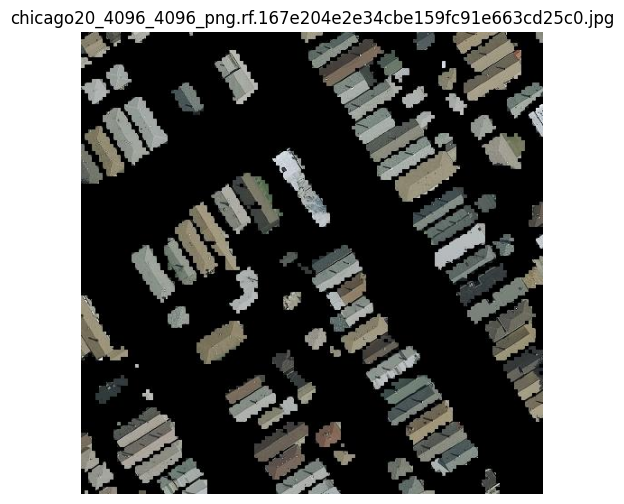

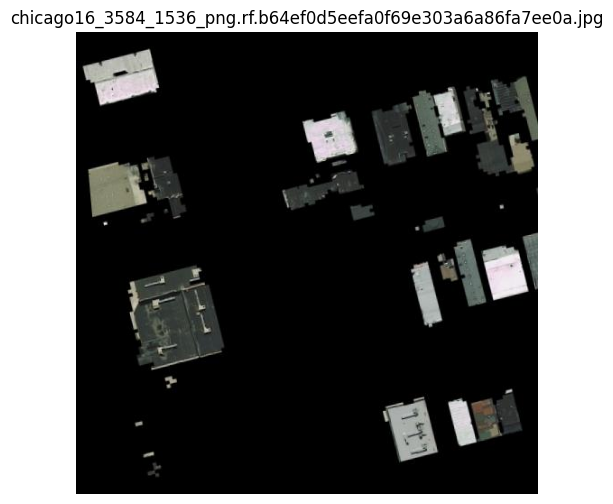

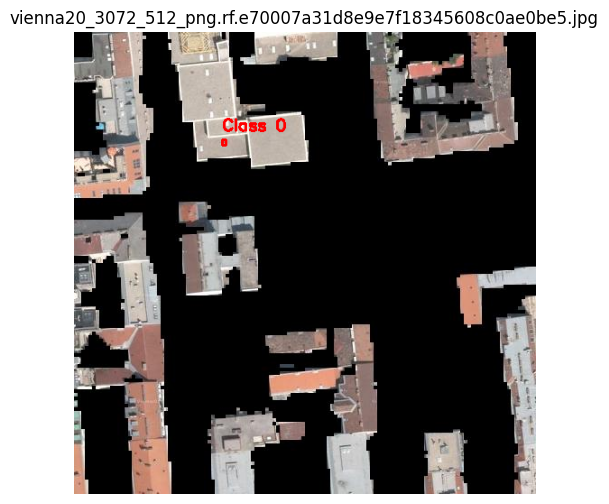

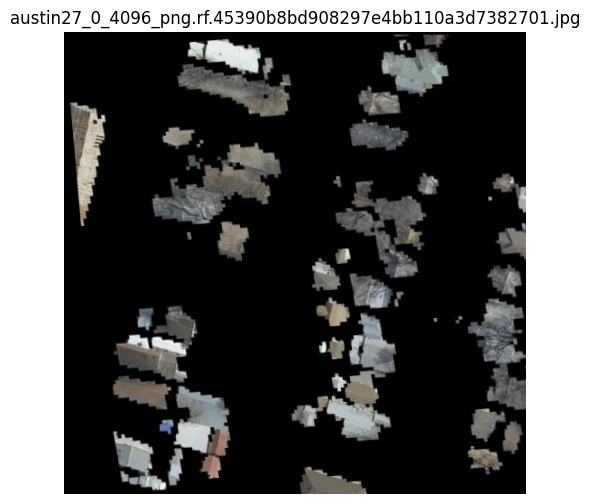

In [8]:
import os
import cv2
import matplotlib.pyplot as plt
import random

# Directorios
base_dir = dataset.location + "/train/"
img_dir = os.path.join(base_dir, "images")
label_dir = os.path.join(base_dir, "labels")

# Obtener archivos
image_files = sorted([f for f in os.listdir(img_dir) if f.endswith(".jpg") or f.endswith(".png")])
sample_files = random.sample(image_files, 4)  # puedes usar random.sample si quieres

for fname in sample_files:
    img_path = os.path.join(img_dir, fname)
    label_path = os.path.join(label_dir, fname.replace(".jpg", ".txt").replace(".png", ".txt"))

    # Cargar imagen
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    h, w, _ = img.shape

    # Dibujar bounding boxes
    if os.path.exists(label_path):
        with open(label_path, "r") as f:
            for line in f:
                cls, x, y, bw, bh = map(float, line.strip().split())
                x1 = int((x - bw / 2) * w)
                y1 = int((y - bh / 2) * h)
                x2 = int((x + bw / 2) * w)
                y2 = int((y + bh / 2) * h)
                cv2.rectangle(img, (x1, y1), (x2, y2), (255, 0, 0), 2)
                cv2.putText(img, f"Class {int(cls)}", (x1, y1 - 10),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)

    # Mostrar imagen
    plt.figure(figsize=(8, 6))
    plt.imshow(img)
    plt.title(fname)
    plt.axis("off")
    plt.show()

In [9]:
from IPython import display
display.clear_output()

# prevent ultralytics from tracking your activity
!yolo settings sync=False

import ultralytics
ultralytics.checks()

Ultralytics 8.3.169 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Setup complete ✅ (4 CPUs, 31.4 GB RAM, 6411.5/8062.4 GB disk)


In [10]:
import os
from pathlib import Path

# Directorios
images_dir = Path(dataset.location+"/train/images")
labels_dir = Path(dataset.location+"/train/labels")

# Archivos de imagen
image_files = list(images_dir.glob("*.jpg")) + list(images_dir.glob("*.png"))

# Contadores
removed = 0

for img_path in image_files:
    label_path = labels_dir / (img_path.stem + ".txt")
    
    if not label_path.exists() or os.path.getsize(label_path) == 0:
        pass
        img_path.unlink()  # Eliminar imagen
        if label_path.exists():
            pass
            label_path.unlink()  # Eliminar etiqueta
        removed += 1

print(f"🧹 Imágenes sin objetos eliminadas: {removed}")

🧹 Imágenes sin objetos eliminadas: 359


In [11]:
!ls {dataset.location}/train/images | wc

    481     481   29912


In [12]:
from ultralytics import YOLO

model = YOLO("yolov8s-p2.yaml")

In [49]:
%%bash
yolo detect train \
  project=troof \
  name=troof_v8s_base \
  exist_ok=True \
  model=yolov8s.pt \
  data=/kaggle/working/troof-4/data.yaml \
  single_cls=True \
  device=0,1 \
  workers=8 \
  amp=True \
  deterministic=True \
  seed=0 \
  imgsz=640 \
  batch=12 \
  epochs=200 \
  patience=60 \
  optimizer=AdamW \
  lr0=0.002 \
  lrf=0.01 \
  cos_lr=True \
  momentum=0.937 \
  weight_decay=0.002 \
  warmup_epochs=3.0 \
  warmup_bias_lr=0.1 \
  box=6.0 \
  cls=0.5 \
  dfl=1.5 \
  iou=0.55 \
  mosaic=0.2 \
  scale=0.5 \
  translate=0.1 \
  perspective=0.0 \
  flipud=0.0 \
  fliplr=0.5 \
  hsv_h=0.015 \
  hsv_s=0.4 \
  hsv_v=0.4 \
  erasing=0.05 \
  mixup=0.0 \
  cutmix=0.0 \
  auto_augment=False \
  overlap_mask=True \
  retina_masks=False \
  val=True \
  plots=True



Ultralytics 8.3.169 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
                                                        CUDA:1 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=False, batch=12, bgr=0.0, box=6.0, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=True, cutmix=0.0, data=/kaggle/working/troof-4/data.yaml, degrees=0.0, deterministic=True, device=0,1, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=200, erasing=0.05, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.4, hsv_v=0.4, imgsz=640, int8=False, iou=0.55, keras=False, kobj=1.0, line_width=None, lr0=0.002, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8s.pt, momentum=0.937, mosaic=0.2, multi_scale=False, name=troof_v8s_base, nbs=64, nms=False, opset=None, optimize=False, optimi

100%|██████████| 21.5M/21.5M [00:00<00:00, 193MB/s]
train: Scanning /kaggle/working/troof-4/train/labels.cache... 481 images, 0 backgrounds, 0 corrupt: 100%|██████████| 481/481 [00:00<?, ?it/s]
val: Scanning /kaggle/working/troof-4/valid/labels.cache... 52 images, 22 backgrounds, 0 corrupt: 100%|██████████| 52/52 [00:00<?, ?it/s]
      1/200      1.56G      2.724      12.37      1.538         13        640: 100%|██████████| 41/41 [00:07<00:00,  5.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.20it/s]
      2/200      1.88G      2.374      3.155      1.199         12        640: 100%|██████████| 41/41 [00:06<00:00,  6.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 10.92it/s]
      3/200      1.92G      2.362      3.195      1.287         12        640: 100%|██████████| 41/41 [00:05<00:00,  7.35it/s]
               

In [50]:
from ultralytics import YOLO
from IPython.display import display
import matplotlib.pyplot as plt
import cv2
from pathlib import Path

# Ruta segura al modelo entrenado
model_path = Path("troof/troof_v8s_base/weights/best.pt")

# Verificar existencia
if not model_path.exists():
    raise FileNotFoundError(f"❌ No se encontró el modelo en: {model_path.resolve()}")

# Cargar modelo
print(f"✅ Cargando modelo desde: {model_path}")
model = YOLO(str(model_path))

# Ruta del conjunto de validación
val_images_path = Path("/kaggle/working/troof-4/valid/images")

# Verificar existencia del conjunto
if not val_images_path.exists():
    raise FileNotFoundError(f"❌ No se encontró el directorio de validación en: {val_images_path.resolve()}")

# Ejecutar inferencia
print("🔍 Ejecutando inferencia sobre conjunto de validación...")
results = model.predict(
    source=str(val_images_path),
    conf=0.15,
    save=True,     # Guarda las predicciones con boxes sobre las imágenes
    verbose=False  # Puedes poner True si deseas ver más información
)

print("✅ Inferencia completada. Archivos guardados en:")
print(results[0].save_dir)


✅ Cargando modelo desde: troof/troof_v8s_base/weights/best.pt
🔍 Ejecutando inferencia sobre conjunto de validación...
Results saved to runs/detect/predict6
✅ Inferencia completada. Archivos guardados en:
runs/detect/predict6


runs/detect/predict6vienna9_1024_4096_png.rf.73203e8ec9d98f8882b49487fe4e2e4e.jpg


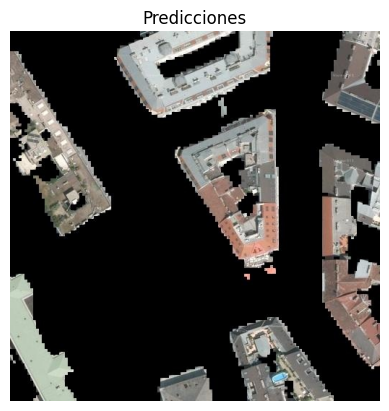

runs/detect/predict6vienna19_0_3584_png.rf.b7f0c42534fa0ff0a3cbcbc0ab65d10c.jpg


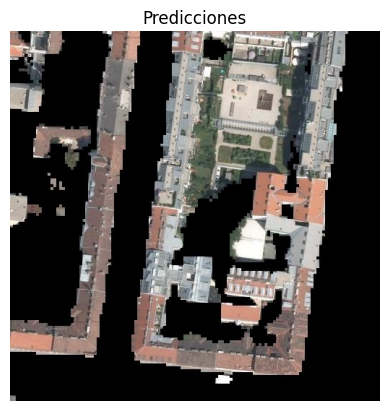

runs/detect/predict6vienna17_3072_0_png.rf.5ae990cc22e0d3182b346c4608592c7d.jpg


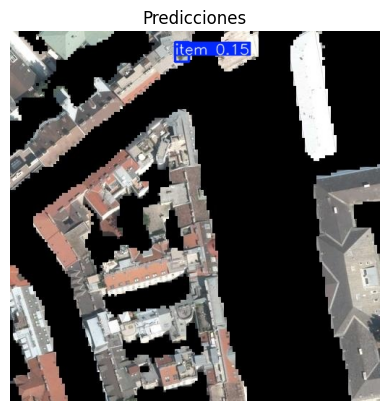

runs/detect/predict6vienna7_3584_3584_png.rf.3bc6786b7820d5a032ddc2cea66af0ed.jpg


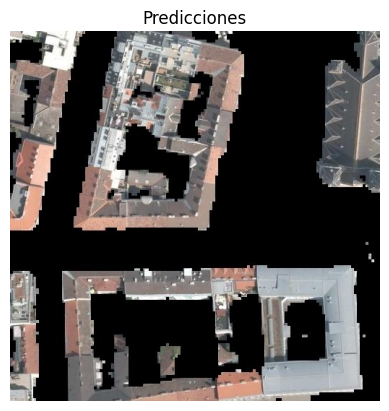

runs/detect/predict6chicago34_1024_3584_png.rf.877948bce3a6a205e84555e66270edbd.jpg


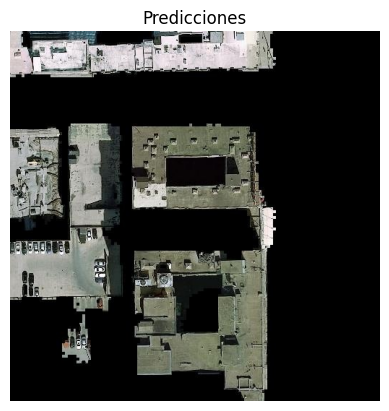

runs/detect/predict6chicago36_2560_3584_png.rf.d676345b8a4011af2455ef4c3f15522b.jpg


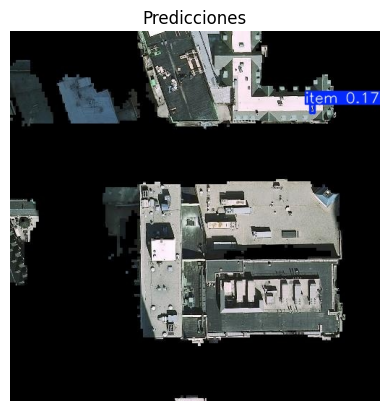

runs/detect/predict6chicago33_2048_4096_png.rf.4e275bccc605fd025fa5f22d3524c33e.jpg


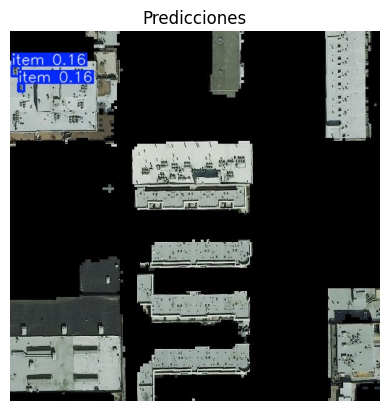

runs/detect/predict6vienna30_1024_2560_png.rf.adb4f5a292a40af06d50b13f83787963.jpg


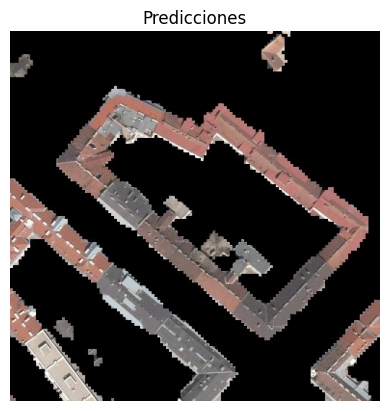

runs/detect/predict6vienna35_2048_0_png.rf.85346cbc386b7614b8fe77838fb5de32.jpg


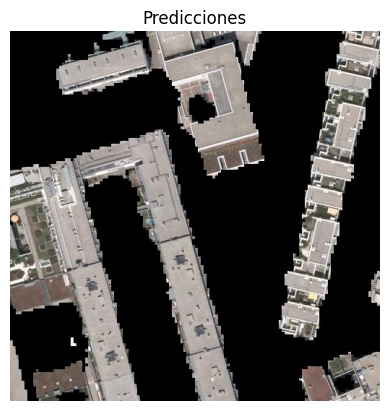

runs/detect/predict6chicago23_3072_4096_png.rf.8518cb5a006cfe0b9e0376065fb2398f.jpg


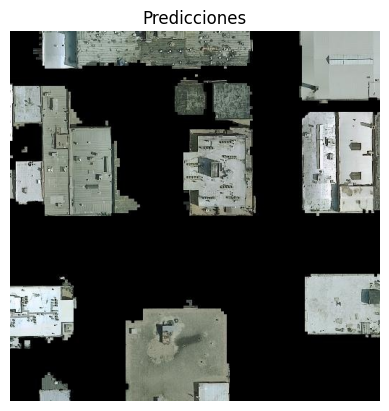

runs/detect/predict6chicago32_0_3584_png.rf.6b03da6b73714a3ff82449f20900c6cc.jpg


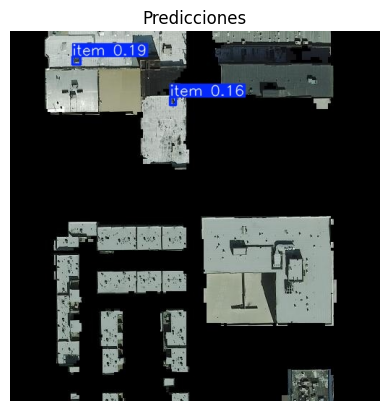

runs/detect/predict6vienna17_1024_1024_png.rf.686de7875d6c74e8f96c15a7be596134.jpg


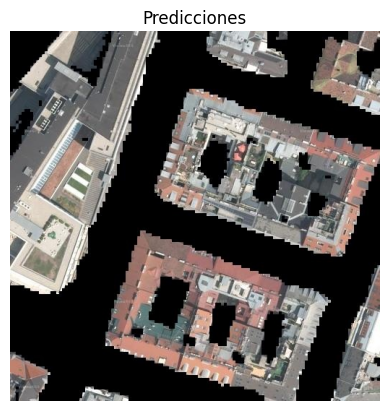

runs/detect/predict6vienna4_1024_2560_png.rf.743d1e16dce06aee8fe5a1b316eec51f.jpg


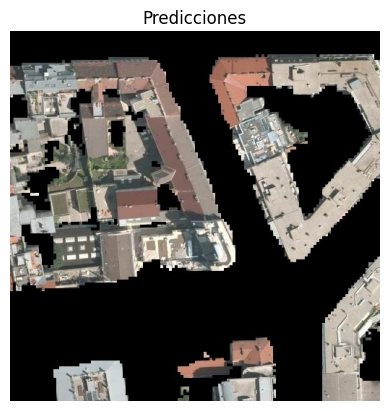

runs/detect/predict6vienna20_1536_3072_png.rf.28a83e66ee02b4e79c707676bcaabbb7.jpg


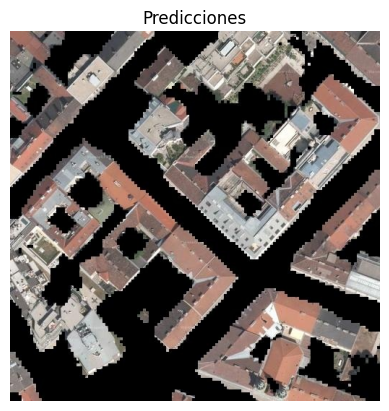

runs/detect/predict6vienna21_2048_512_png.rf.4fd8a7a67ef613d62418bf37823013bb.jpg


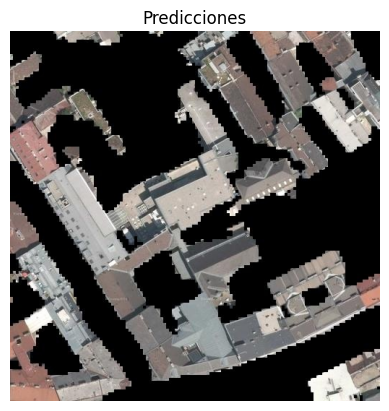

runs/detect/predict6austin18_1024_3584_png.rf.8bc5e9f2481ffeb0eba05bbb213ed44e.jpg


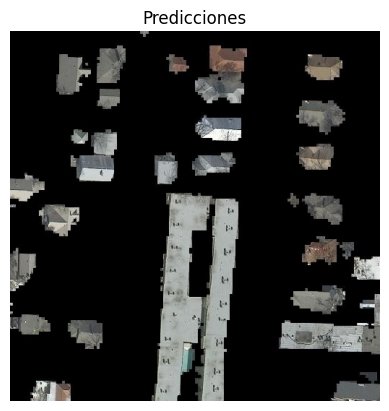

runs/detect/predict6vienna11_1536_512_png.rf.57ce6102f8ff0c096755500a1d420488.jpg


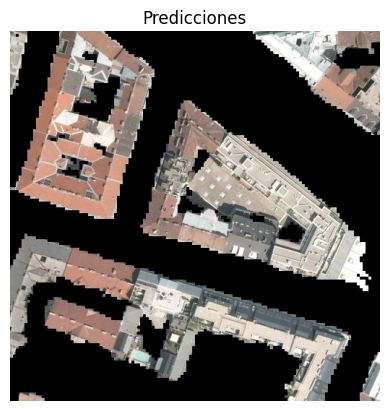

runs/detect/predict6vienna26_2048_0_png.rf.4e27ed5e0aabafdb7f245ed4f8ca9dab.jpg


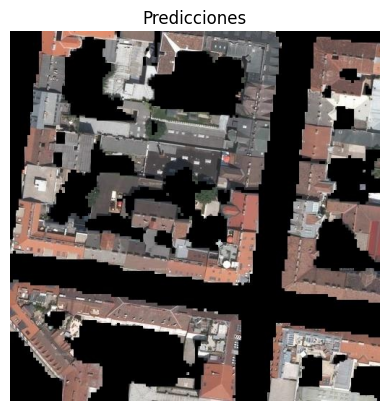

runs/detect/predict6vienna10_3584_3584_png.rf.00077abcfdb935b1a1381c6525adb70f.jpg


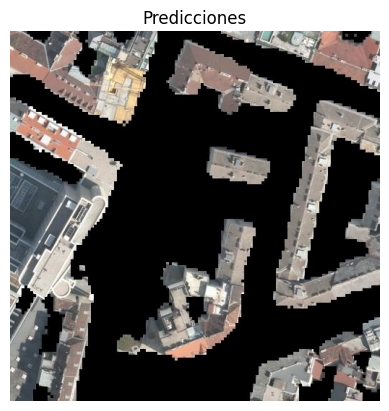

runs/detect/predict6vienna4_2560_2560_png.rf.75934a81f09e2adcc6fae625ab70fa8e.jpg


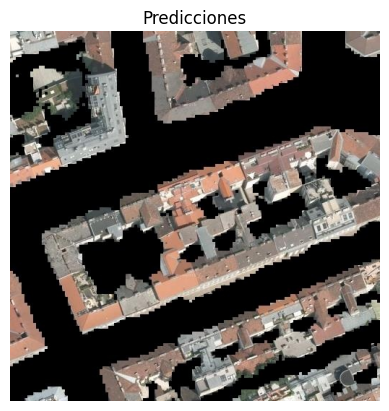

runs/detect/predict6chicago29_0_0_png.rf.c815f3fb3a3455b12a486f6b4ce3a5bc.jpg


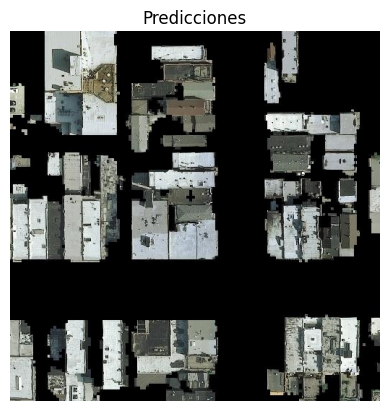

runs/detect/predict6vienna19_1024_2560_png.rf.c527f120e39230c686ad03d19ae151df.jpg


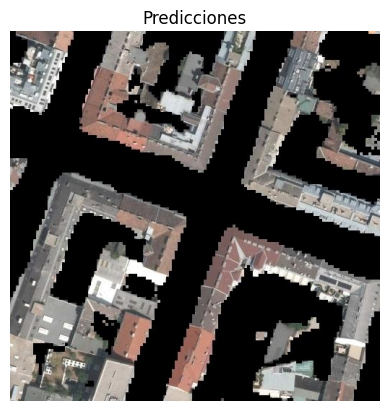

runs/detect/predict6vienna16_512_0_png.rf.efe641998fb9edfe5ab882212a987d31.jpg


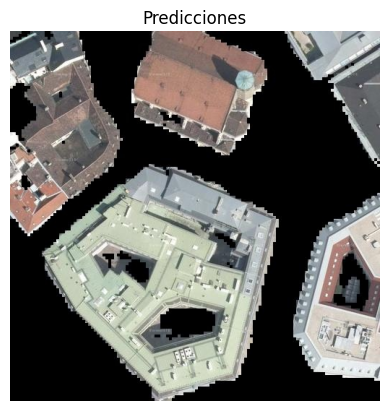

runs/detect/predict6chicago27_3072_512_png.rf.97290450e94b0d2b256b14035a17467a.jpg


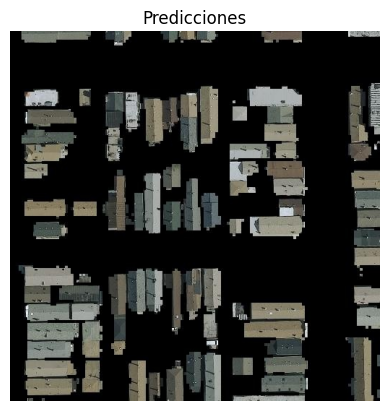

runs/detect/predict6austin26_2560_3072_png.rf.101a432074f8e9cf6980bfc28d6227dc.jpg


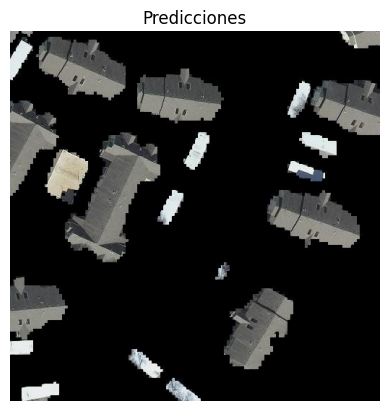

runs/detect/predict6chicago16_3072_512_png.rf.91a8aed369e53445f561680e495455f5.jpg


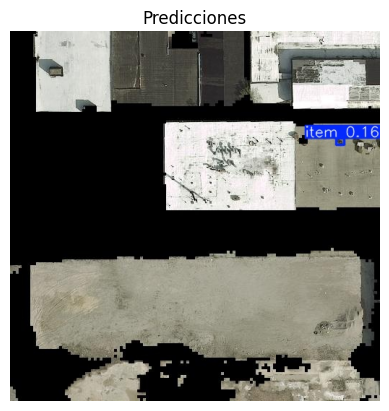

runs/detect/predict6chicago35_4096_1536_png.rf.f6419a737b9660155b69fbb190aec66b.jpg


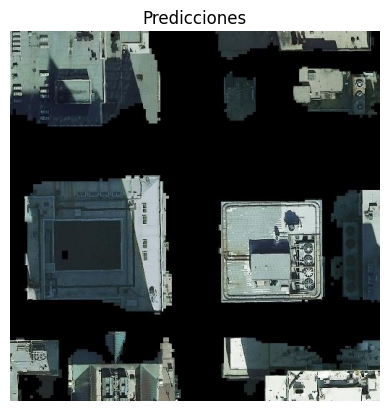

runs/detect/predict6vienna20_2560_3072_png.rf.7f8056bad2d99875afc646557151a1b2.jpg


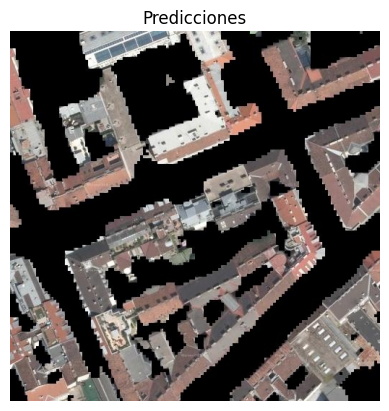

runs/detect/predict6chicago19_3072_2560_png.rf.6d0932255ef4fa2978621e1fa03d8964.jpg


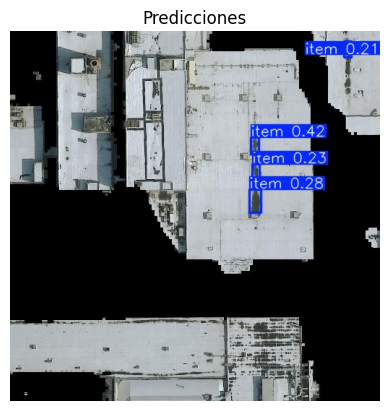

runs/detect/predict6vienna23_1536_4096_png.rf.3eaf6d50a82a20e99c9f4f5afd9f8998.jpg


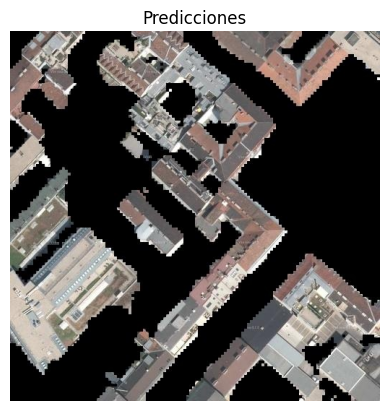

runs/detect/predict6vienna22_0_2048_png.rf.a37cfcc3349e5abb7c0797ab6591d7ab.jpg


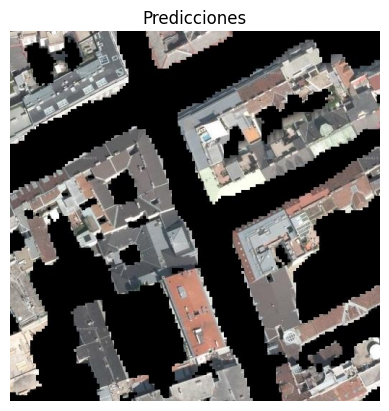

runs/detect/predict6chicago29_3072_2048_png.rf.266ecb9ec2bf39d5a7ccab430df1b539.jpg


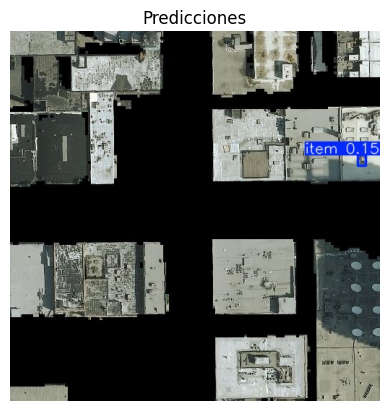

runs/detect/predict6vienna2_3584_3584_png.rf.b518ac4d61a909b48cfb335265ed1e21.jpg


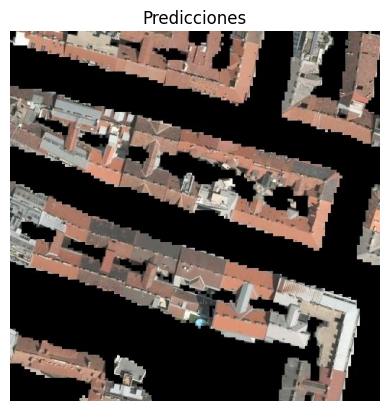

runs/detect/predict6vienna20_1536_512_png.rf.2ab5073c40a536efb5e4a6b2ab18ea94.jpg


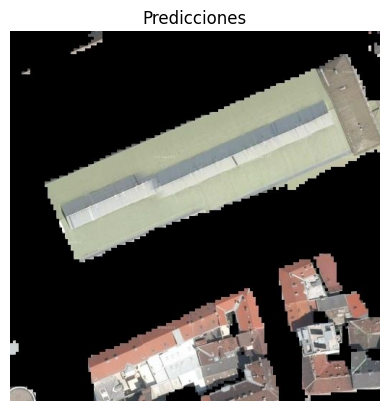

runs/detect/predict6vienna21_4096_4096_png.rf.1dabcc8af73e790be8a74345e84b2a92.jpg


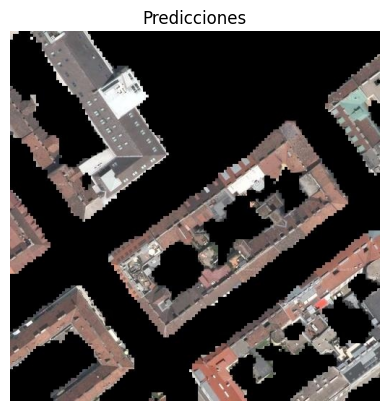

runs/detect/predict6vienna8_3584_1536_png.rf.52e6e220fc939a1e88dbf6d519b5c913.jpg


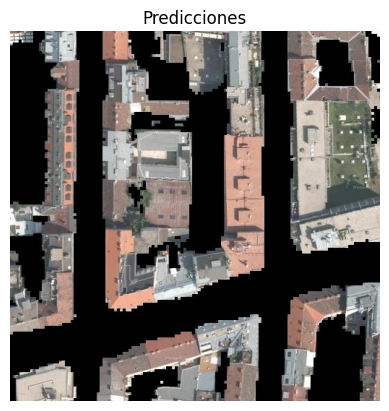

runs/detect/predict6chicago8_2560_3584_png.rf.896157e821eceb74e2031ef19088fd93.jpg


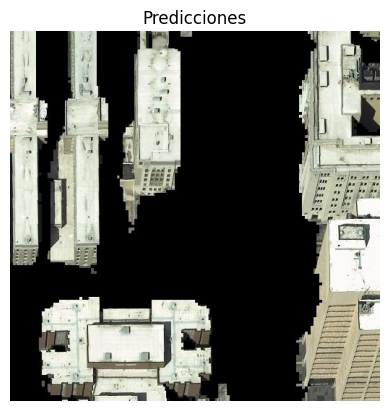

runs/detect/predict6vienna20_3584_1536_png.rf.68c4d1311171264fc65a5aa85d52a548.jpg


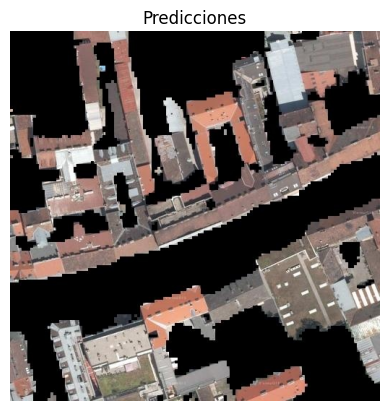

runs/detect/predict6vienna28_1024_1536_png.rf.6429ccf9eb5e7346cc78307711a1cfe2.jpg


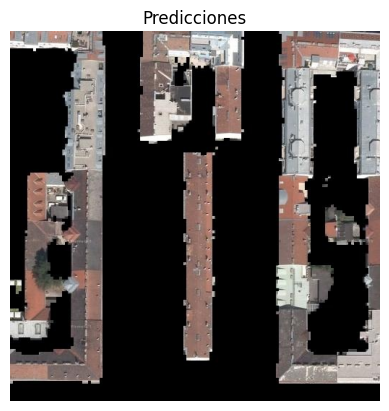

runs/detect/predict6vienna17_4096_1024_png.rf.770b52f02754457ed17c7c7c25a7a600.jpg


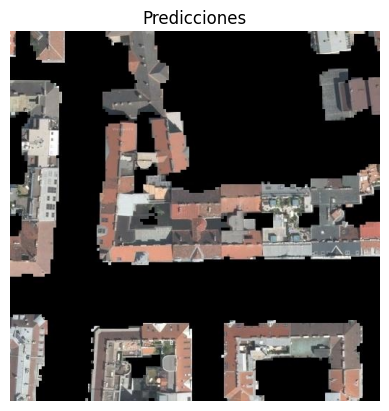

runs/detect/predict6vienna11_1024_2560_png.rf.a6cee78ec15343064f899ee40b7e089e.jpg


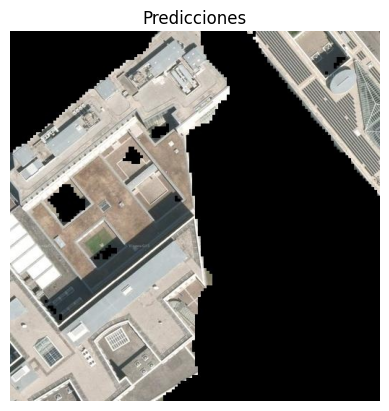

runs/detect/predict6austin19_512_2048_png.rf.2d82785e2e4857c7b6e25db798e4f792.jpg


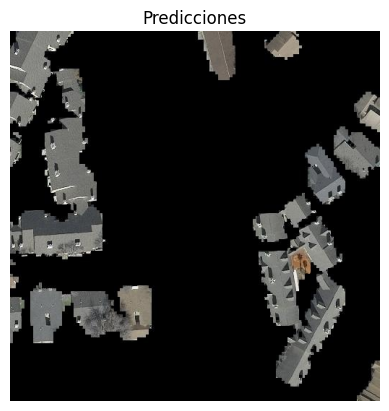

runs/detect/predict6vienna20_2048_0_png.rf.dadd3bc2909f6f6989e568840cd84d0d.jpg


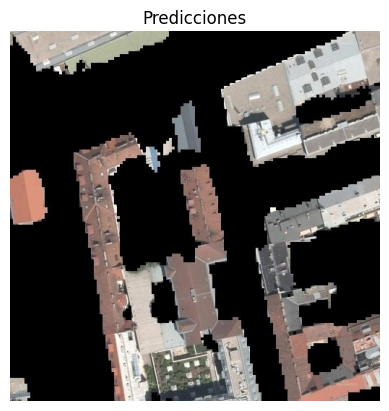

runs/detect/predict6vienna7_4096_3584_png.rf.c3cec4c551986be570168445ee120c7a.jpg


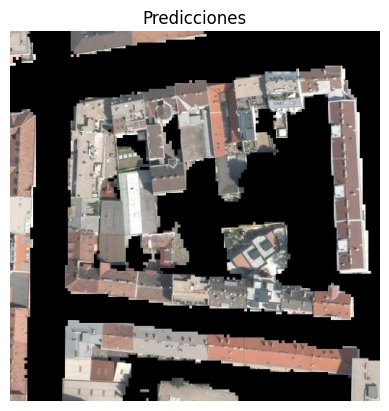

runs/detect/predict6vienna8_512_3072_png.rf.eee21dc751385bcff1a03da9a4a2eb97.jpg


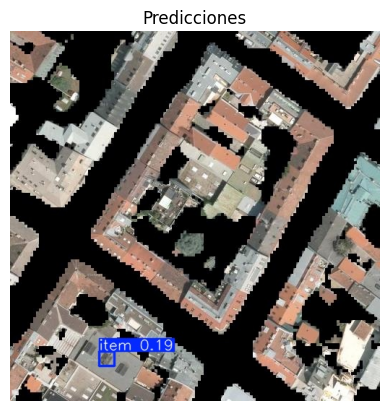

runs/detect/predict6vienna17_3584_3072_png.rf.de8df0caf5df440bbafde60667d473d2.jpg


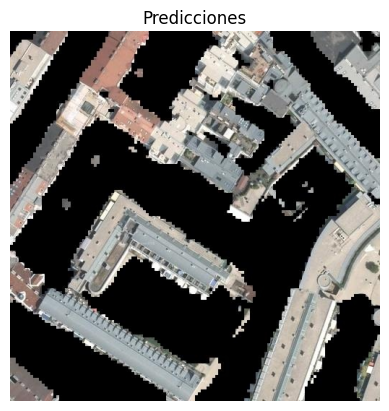

runs/detect/predict6vienna22_3072_1024_png.rf.4a73e17c85fb6719faa9627a82ab9b90.jpg


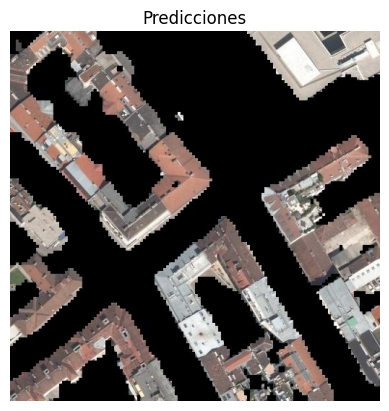

runs/detect/predict6chicago23_4096_0_png.rf.42f672cdf90b3748c3ec3edde4c6284b.jpg


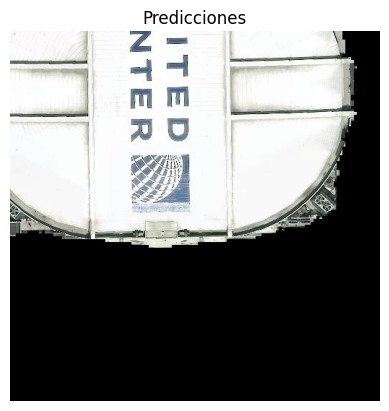

runs/detect/predict6vienna17_2048_0_png.rf.a38e9bbe62cbb95bbf9c0b16107d7637.jpg


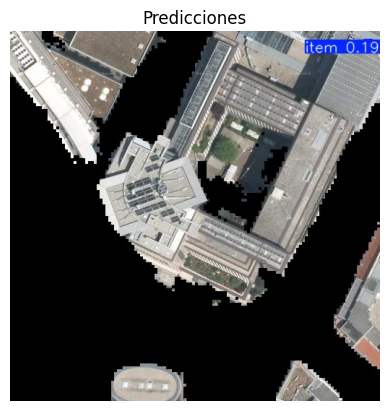

runs/detect/predict6vienna14_3584_1536_png.rf.8edf85f4ed4a422e7b94ec7359c6070a.jpg


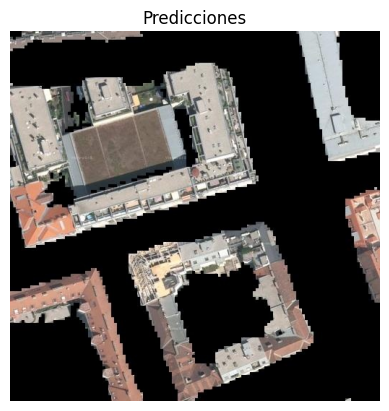

runs/detect/predict6vienna7_2560_3584_png.rf.fedfda327121ba6c03f39960a1a24781.jpg


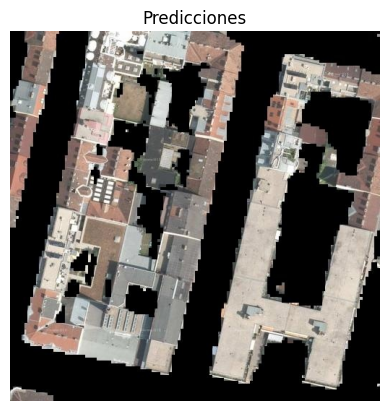

runs/detect/predict6chicago24_1024_3072_png.rf.8a0f14f14fdaa35afd54d91a8a8f38b6.jpg


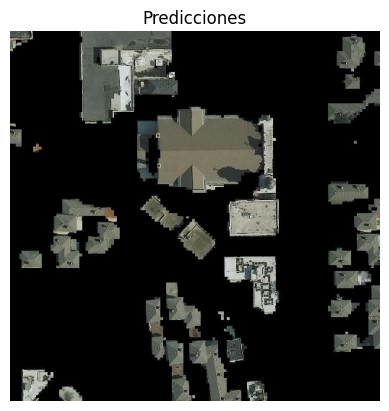

In [51]:
for image in os.listdir(results[0].save_dir):
    print(results[0].save_dir + image)
    img = cv2.imread(results[0].save_dir + "/" + image)  # cambia por una imagen real
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.title("Predicciones")
    plt.show()

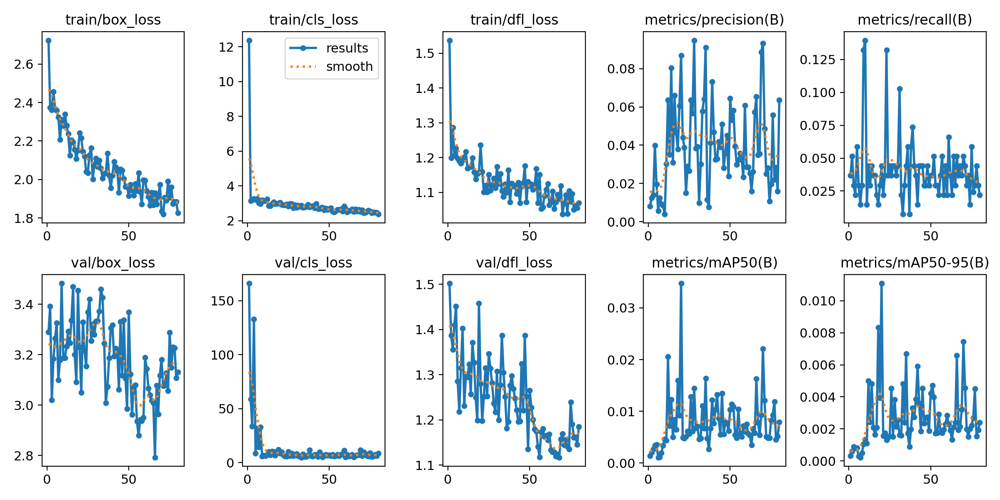

In [52]:
from IPython.display import Image
from pathlib import Path

# Ruta segura
img_path = Path("troof/troof_v8s_base/results.png")

# Verificar existencia
if img_path.exists():
    display(Image(filename=str(img_path), width=600))
else:
    print(f"❌ No se encontró la imagen en: {img_path.resolve()}")

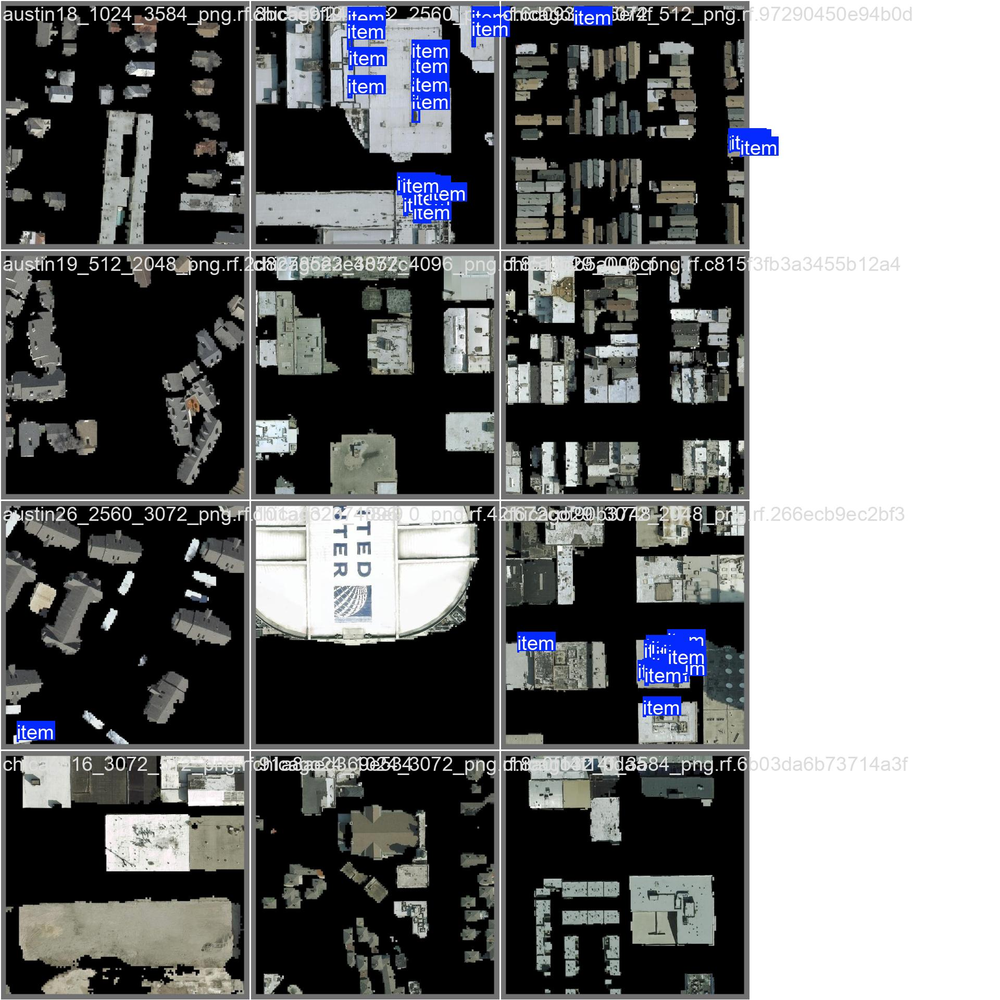

In [53]:
from IPython.display import Image
from pathlib import Path

# Ruta segura a la imagen generada durante validación
val_labels_img = Path("troof/troof_v8s_base/val_batch0_labels.jpg")

if val_labels_img.exists():
    display(Image(filename=str(val_labels_img), width=600))
else:
    print(f"❌ No se encontró la imagen en: {val_labels_img.resolve()}")

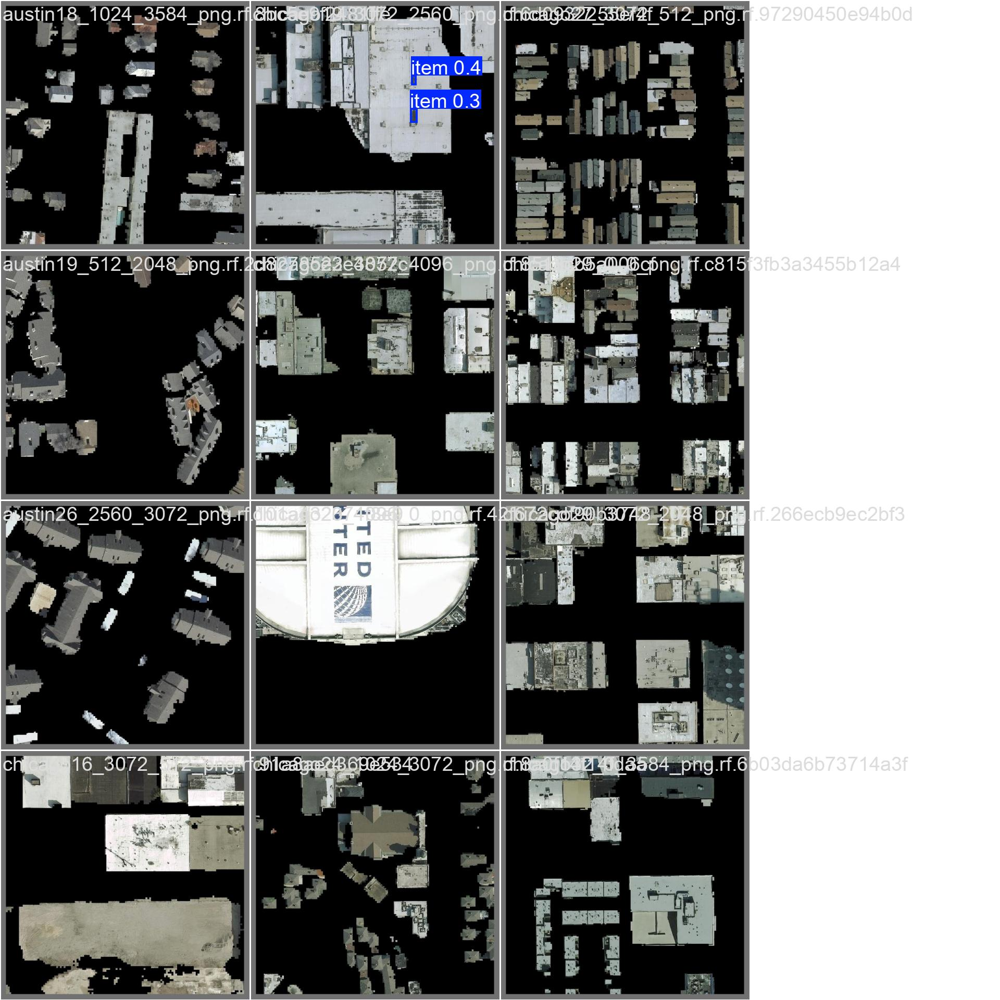

In [54]:
from IPython.display import Image
from pathlib import Path

val_pred_img = Path("troof/troof_v8s_base/val_batch0_pred.jpg")

if val_pred_img.exists():
    display(Image(filename=str(val_pred_img), width=601))
else:
    print(f"❌ No se encontró la imagen: {val_pred_img.resolve()}")

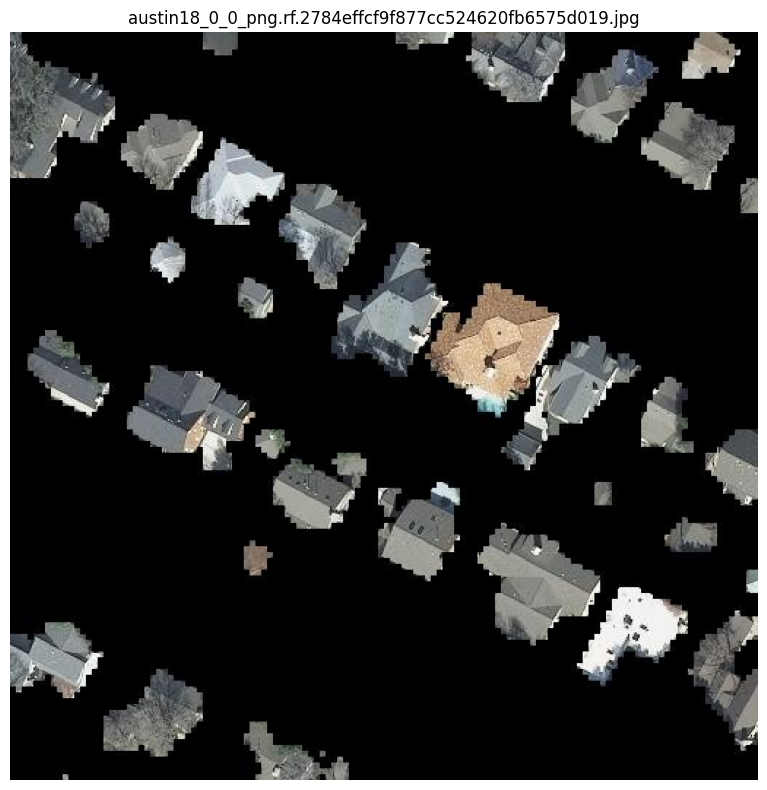

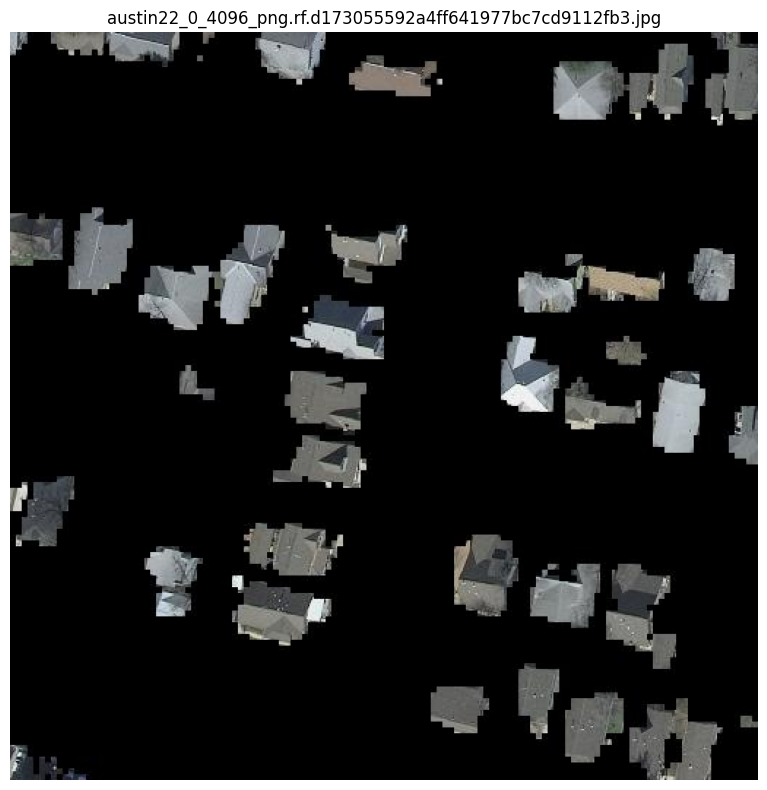

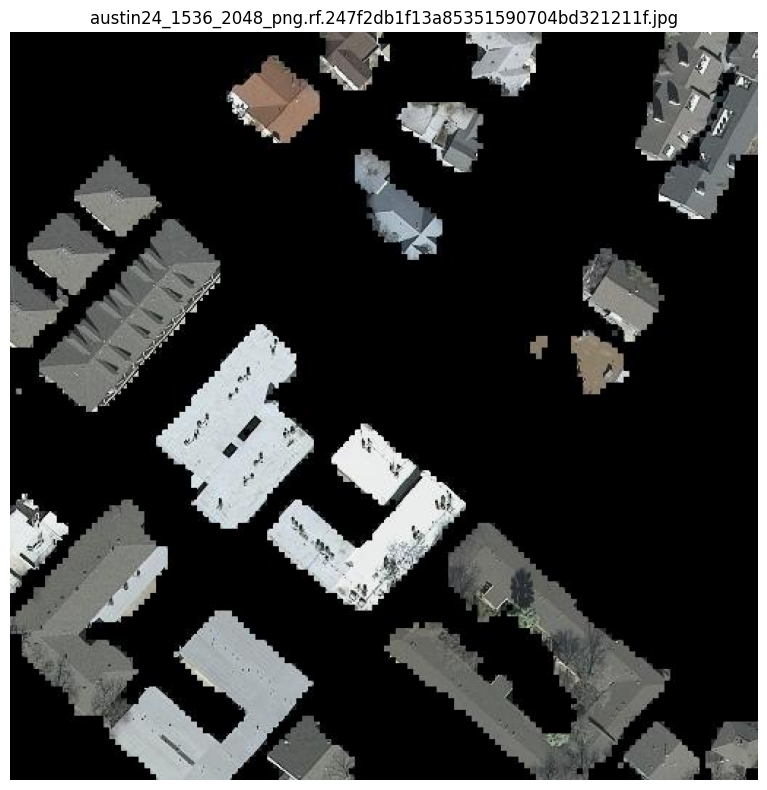

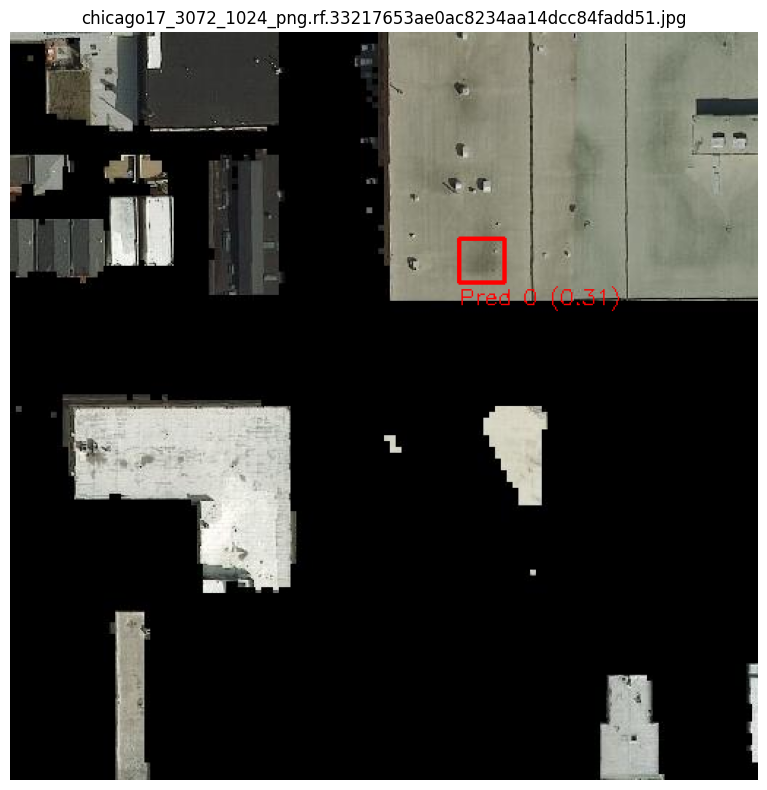

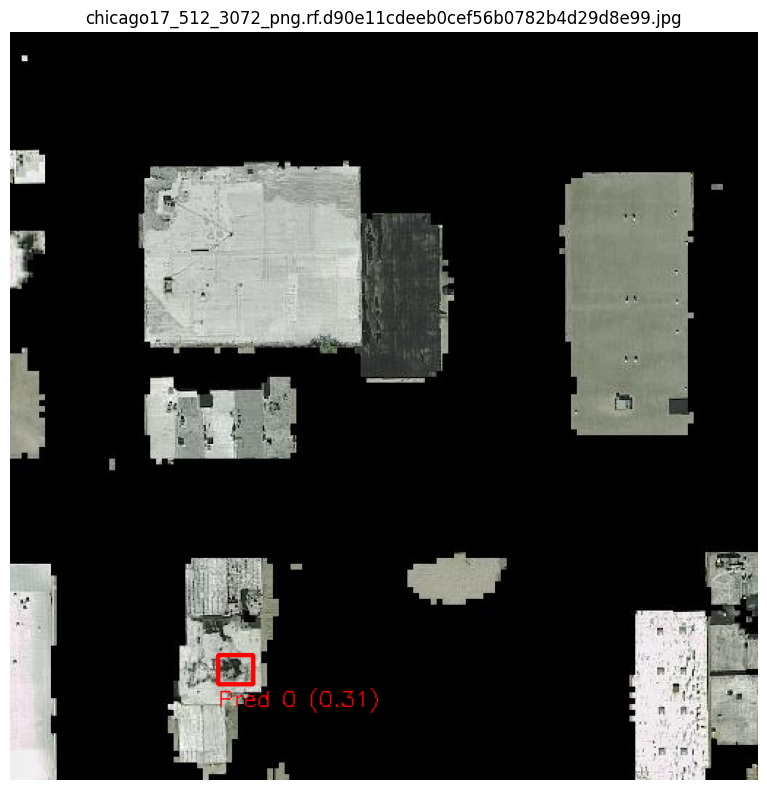

...

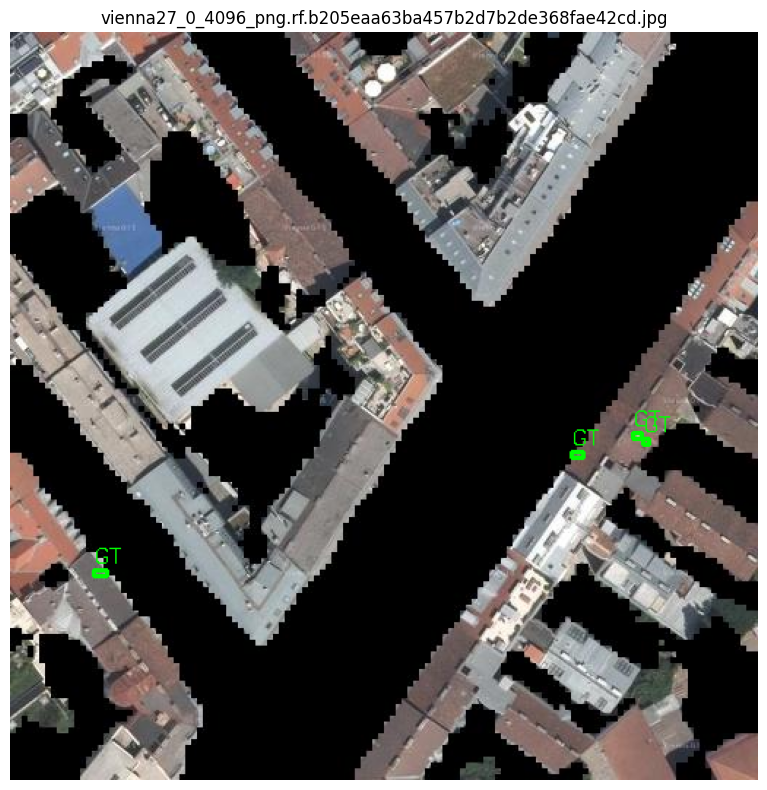

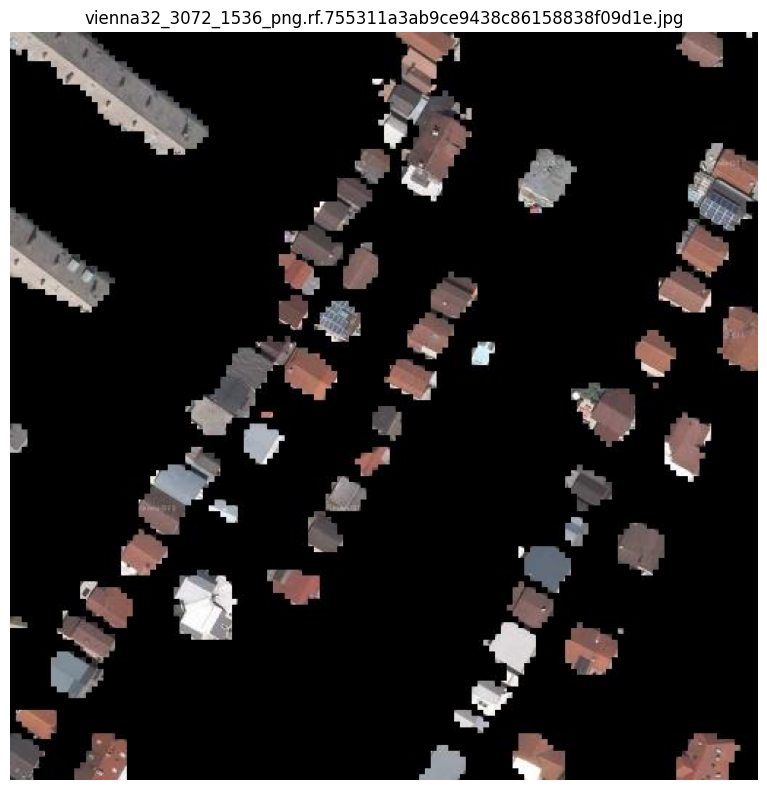

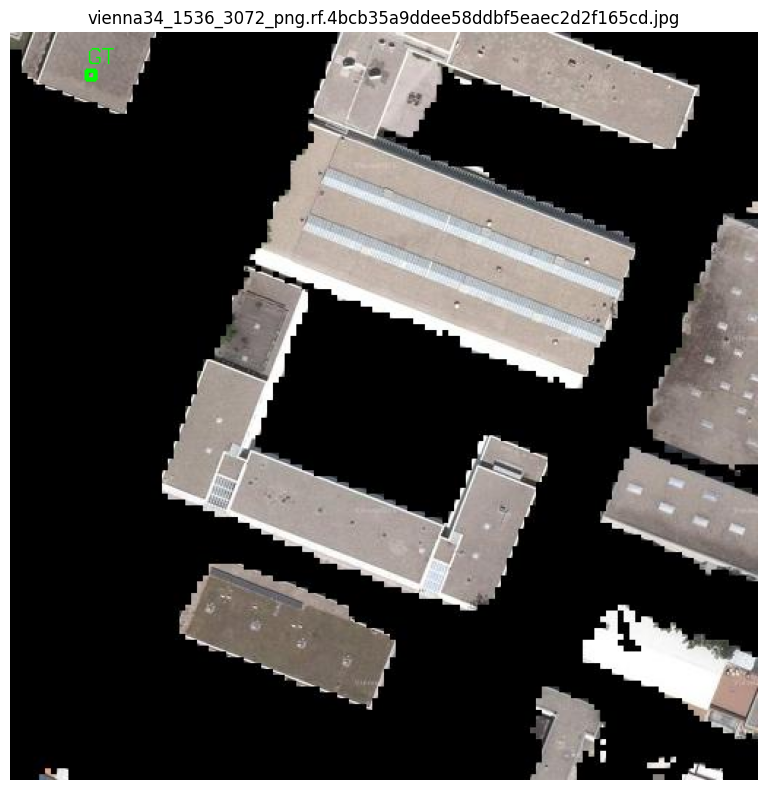

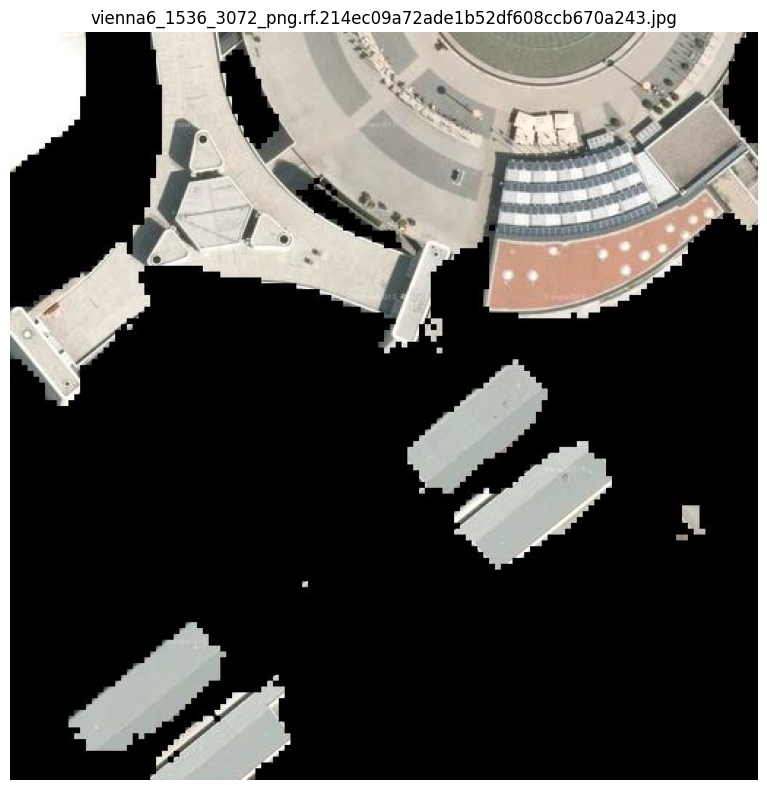

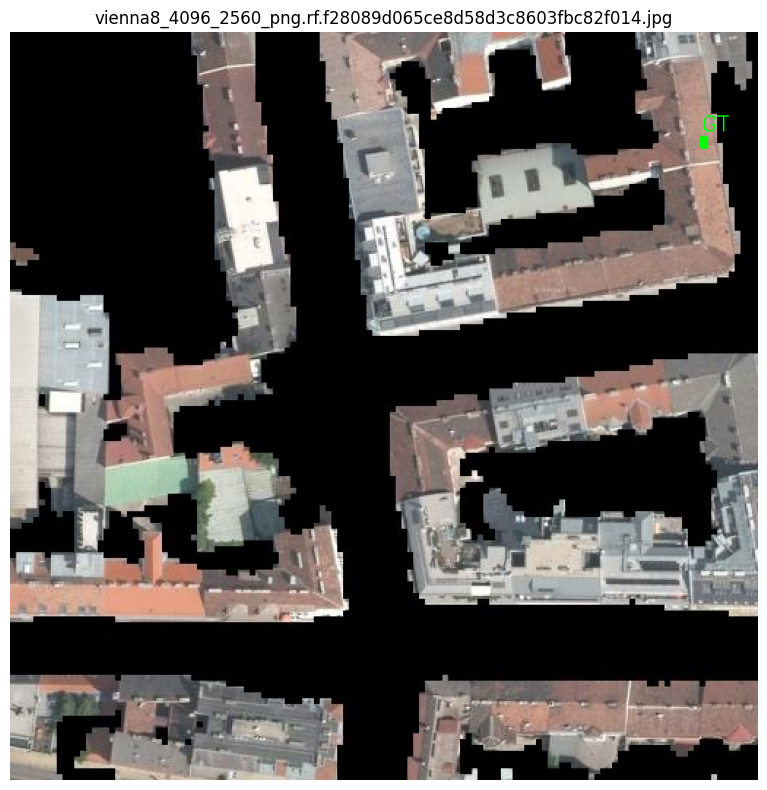

In [55]:
import os
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path
from ultralytics import YOLO

# ─── Rutas ─────────────────────────────────────────────────────────────
model_path = Path("troof/troof_v8s_base/weights/best.pt")
test_dir = Path(dataset.location) / "test"
images_dir = test_dir / "images"
labels_dir = test_dir / "labels"
results_dir = Path("results")
results_dir.mkdir(exist_ok=True)

# ─── Verificación ───────────────────────────────────────────────────────
assert model_path.exists(), f"❌ Modelo no encontrado: {model_path.resolve()}"
assert images_dir.exists(), f"❌ Directorio de imágenes no encontrado: {images_dir.resolve()}"
assert labels_dir.exists(), f"❌ Directorio de etiquetas no encontrado: {labels_dir.resolve()}"

# ─── Cargar modelo ──────────────────────────────────────────────────────
model = YOLO(str(model_path))

# ─── Iterar sobre imágenes ──────────────────────────────────────────────
image_files = sorted(images_dir.glob("*.jpg")) + sorted(images_dir.glob("*.png"))

for img_path in image_files:
    try:
        img = cv2.imread(str(img_path))
        if img is None:
            raise ValueError(f"⚠️ No se pudo leer la imagen: {img_path}")
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        h, w, _ = img.shape

        # ─── Dibujar etiquetas reales (verde) ─────
        label_path = labels_dir / f"{img_path.stem}.txt"
        if label_path.exists():
            with open(label_path, "r") as f:
                for line in f:
                    cls, cx, cy, bw, bh = map(float, line.strip().split())
                    x1 = int((cx - bw / 2) * w)
                    y1 = int((cy - bh / 2) * h)
                    x2 = int((cx + bw / 2) * w)
                    y2 = int((cy + bh / 2) * h)
                    cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)
                    cv2.putText(img, "GT", (x1, y1 - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)

        # ─── Ejecutar predicción ────────────────
        results = model.predict(source=str(img_path), conf=0.3, verbose=False)
        boxes = results[0].boxes

        # ─── Dibujar predicciones (azul) ────────
        for box in boxes:
            x1, y1, x2, y2 = map(int, box.xyxy[0])
            conf = float(box.conf[0])
            cls_id = int(box.cls[0])
            cv2.rectangle(img, (x1, y1), (x2, y2), (255, 0, 0), 2)
            cv2.putText(img, f"Pred {cls_id} ({conf:.2f})", (x1, y2 + 15),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 1)

        # ─── Mostrar imagen ─────────────────────
        plt.figure(figsize=(10, 8))
        plt.imshow(img)
        plt.title(img_path.name)
        plt.axis("off")
        plt.tight_layout()
        plt.show()

        # ─── Métricas por imagen ────────────────
        roof_area_px = h * w
        damage_count = len(boxes)
        damage_density = damage_count / (roof_area_px + 1e-6)
        confidences = [float(box.conf[0]) for box in boxes]
        mean_conf = np.mean(confidences) if confidences else 0.0
        max_conf = np.max(confidences) if confidences else 0.0

        metrics = {
            "image": img_path.name,
            "roof_area_px": roof_area_px,
            "damage_count": damage_count,
            "damage_density": round(damage_density, 6),
            "mean_confidence": round(mean_conf, 4),
            "max_confidence": round(max_conf, 4)
        }

        # ─── Guardar CSV ────────────────────────
        pd.DataFrame([metrics]).to_csv(results_dir / f"{img_path.stem}_metrics.csv", index=False)
    
    except Exception as e:
        print(f"⚠️ Error procesando {img_path.name}: {e}")


In [56]:
from kaggle_secrets import UserSecretsClient
from huggingface_hub import create_repo

# Cargar token desde los secretos de Kaggle
user_secrets = UserSecretsClient()
hf_token = user_secrets.get_secret("HF_TOKEN")

# Crear el repositorio bajo TU usuario real
repo_url = create_repo(
    repo_id="jobejaranom/yolo-roof-damage",  # ← CORREGIDO
    private=False,
    exist_ok=True,
    token=hf_token
)

print("✅ Repositorio creado:", repo_url)

✅ Repositorio creado: https://huggingface.co/jobejaranom/yolo-roof-damage


In [57]:
from kaggle_secrets import UserSecretsClient
from huggingface_hub import HfApi, HfFolder, upload_folder
from pathlib import Path

# --- Autenticación segura desde secretos de Kaggle ---
user_secrets = UserSecretsClient()
hf_token = user_secrets.get_secret("HF_TOKEN")

# Validar token
if not hf_token:
    raise ValueError("❌ Token HF_TOKEN no encontrado en los secretos de Kaggle.")

# Guardar token localmente para el SDK
HfFolder.save_token(hf_token)

# --- Parámetros del repositorio ---
repo_id = "jobejaranom/yolo-roof-damage"  # Asegúrate de que sea tu repositorio
model_path = Path("troof/troof_v8s_base")  # Ajusta si la ruta cambió
path_in_repo = "yolov8"  # Carpeta dentro del repositorio
commit_msg = "🚀 Upload trained YOLOv8 model for defect detection"

# --- Verificar existencia de carpeta ---
if not model_path.exists() or not model_path.is_dir():
    raise FileNotFoundError(f"❌ Ruta no válida: {model_path.resolve()}")

# --- Subida a Hugging Face Hub ---
api = HfApi()
upload_folder(
    repo_id=repo_id,
    folder_path=str(model_path),
    path_in_repo=path_in_repo,
    commit_message=commit_msg,
)

print(f"✅ Modelo subido correctamente a: https://huggingface.co/{repo_id}/tree/main/{path_in_repo}")


Uploading...:   0%|          | 0.00/49.5M [00:00<?, ?B/s]

✅ Modelo subido correctamente a: https://huggingface.co/jobejaranom/yolo-roof-damage/tree/main/yolov8
